### Graph and with/without HMM labeling and position linearization
This functions were developed on top of the track_linearization library from the Frank Lab

In [1]:
import numpy as np
import pandas as pd
import networkx as nx
import seaborn as sns
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
from IPython.display import HTML
from matplotlib.animation import FuncAnimation
from pfr_track_linearization import*

In [2]:
# Simulation of Y-Maze tracking data
# Define the number of points per arm and the total number of frames
num_points = 50
num_frames = 8 * num_points  # Total frames for the animation (8 segments)

# Define the starting point for Arm 1 (center of the Y-maze)
start_x, start_y = 100, 0

# Generate position data for Y-maze arms
# Arm 1: Vertical line from (100, 0) to (100, 100)
arm1_x_forward = np.full(num_points, start_x)  # Constant x-coordinate
arm1_y_forward = np.linspace(start_y, start_y + 100, num_points)  # Linearly spaced y-coordinates
arm1_x_backward = arm1_x_forward[::-1]  # Reverse the x-coordinates
arm1_y_backward = arm1_y_forward[::-1]  # Reverse the y-coordinates

# Arm 2: Starts at (100, 100) and extends at 150°
theta_2 = 150 * np.pi / 180  # Convert angle to radians
arm2_x_forward = start_x + np.linspace(0, 100, num_points) * np.cos(theta_2)
arm2_y_forward = start_y + 100 + np.linspace(0, 100, num_points) * np.sin(theta_2)
arm2_x_backward = arm2_x_forward[::-1]  # Reverse the x-coordinates
arm2_y_backward = arm2_y_forward[::-1]  # Reverse the y-coordinates

# Arm 3: Starts at (100, 100) and extends at -30°
theta_3 = 30 * np.pi / 180  # Convert angle to radians
arm3_x_forward = start_x + np.linspace(0, 100, num_points) * np.cos(theta_3)
arm3_y_forward = start_y + 100 + np.linspace(0, 100, num_points) * np.sin(theta_3)
arm3_x_backward = arm3_x_forward[::-1]  # Reverse the x-coordinates
arm3_y_backward = arm3_y_forward[::-1]  # Reverse the y-coordinates

# Combine all segments into a single trajectory
trajectory_x = np.concatenate([
    arm1_x_forward,  # Forward along arm 1
    arm2_x_forward,  # Forward along arm 2
    arm2_x_backward,  # Backward along arm 2
    arm1_x_backward,  # Backward along arm 1
    arm1_x_forward,  # Forward along arm 1 again
    arm3_x_forward,  # Forward along arm 3
    arm3_x_backward,  # Backward along arm 3
    arm2_x_forward   # Forward along arm 2 (final movement)
])

trajectory_y = np.concatenate([
    arm1_y_forward,  # Forward along arm 1
    arm2_y_forward,  # Forward along arm 2
    arm2_y_backward,  # Backward along arm 2
    arm1_y_backward,  # Backward along arm 1
    arm1_y_forward,  # Forward along arm 1 again
    arm3_y_forward,  # Forward along arm 3
    arm3_y_backward,  # Backward along arm 3
    arm2_y_forward   # Forward along arm 2 (final movement)
])

# Add noise to simulate measurement errors
noise = np.random.multivariate_normal([0, 0], [[0.5, 0], [0, 0.5]], len(trajectory_x))  # Shape: (400, 2)
trajectory_x += noise[:, 0]
trajectory_y += noise[:, 1]
position = np.vstack((trajectory_x, trajectory_y)).T

In [3]:
# def calculate_transitions_simple(track_graph, edges, diagonal_bias=0.1):
#     """Original simple connectivity-based transition calculation"""
#     n_edges = len(edges)
#     transitions = np.zeros((n_edges, n_edges))
    
#     for i, edge1 in enumerate(edges):
#         for j, edge2 in enumerate(edges):
#             # Allow transitions between connected segments
#             if set(edge1) & set(edge2):  # if edges share a node
#                 transitions[i, j] = 1.0
    
#     # Increase probability of staying on current segment
#     np.fill_diagonal(transitions, diagonal_bias)
#     # Normalize
#     transitions /= transitions.sum(axis=1, keepdims=True)
#     return transitions

# def calculate_transitions_with_angles(track_graph, edges, diagonal_bias=0.1):
#     """Calculate transitions considering segment angles at junctions"""
#     n_edges = len(edges)
#     transitions = np.zeros((n_edges, n_edges))
    
#     for i, edge1 in enumerate(edges):
#         for j, edge2 in enumerate(edges):
#             # Check if edges share a node
#             common_nodes = set(edge1) & set(edge2)
#             if common_nodes:
#                 junction_node = list(common_nodes)[0]
                
#                 # Get vectors for both segments
#                 vec1 = np.array(track_graph.nodes[edge1[1]]['pos']) - \
#                        np.array(track_graph.nodes[edge1[0]]['pos'])
#                 vec2 = np.array(track_graph.nodes[edge2[1]]['pos']) - \
#                        np.array(track_graph.nodes[edge2[0]]['pos'])
                
#                 # Calculate angle between segments
#                 angle = np.abs(np.arctan2(vec2[1], vec2[0]) - 
#                              np.arctan2(vec1[1], vec1[0]))
                
#                 # Higher probability for smoother transitions
#                 transitions[i, j] = np.cos(angle/2)  # Smoother turns = higher probability
    
#     # Add bias for staying in same segment
#     np.fill_diagonal(transitions, diagonal_bias)
#     # Normalize
#     transitions /= transitions.sum(axis=1, keepdims=True)
#     return transitions

# def calculate_transitions_with_distance(track_graph, edges, diagonal_bias=0.1):
#     """Calculate transitions considering segment lengths"""
#     n_edges = len(edges)
#     transitions = np.zeros((n_edges, n_edges))
    
#     for i, edge1 in enumerate(edges):
#         edge1_length = track_graph.edges[edge1]['distance']
#         for j, edge2 in enumerate(edges):
#             if set(edge1) & set(edge2):
#                 edge2_length = track_graph.edges[edge2]['distance']
#                 # Favor transitions to similar length segments
#                 length_ratio = min(edge1_length, edge2_length) / \
#                              max(edge1_length, edge2_length)
#                 transitions[i, j] = length_ratio
    
#     np.fill_diagonal(transitions, diagonal_bias)
#     transitions /= transitions.sum(axis=1, keepdims=True)
#     return transitions

# def calculate_transitions_with_junction_type(track_graph, edges, diagonal_bias=0.1):
#     """Calculate transitions considering junction types (T, Y, Cross)"""
#     n_edges = len(edges)
#     transitions = np.zeros((n_edges, n_edges))
    
#     # Find junction nodes and their types
#     junction_nodes = {}
#     for node in track_graph.nodes():
#         degree = track_graph.degree(node)
#         if degree > 2:
#             junction_nodes[node] = degree
    
#     for i, edge1 in enumerate(edges):
#         for j, edge2 in enumerate(edges):
#             common_nodes = set(edge1) & set(edge2)
#             if common_nodes:
#                 junction_node = list(common_nodes)[0]
#                 if junction_node in junction_nodes:
#                     # Adjust probability based on junction type
#                     n_branches = junction_nodes[junction_node]
#                     transitions[i, j] = 1.0 / (n_branches - 1)
    
#     np.fill_diagonal(transitions, diagonal_bias)
#     transitions /= transitions.sum(axis=1, keepdims=True)
#     return transitions

# def create_track_graph(node_positions=None, edges=None):
#     """Create a graph representation of the track."""
#     track_graph = nx.Graph()
    
#     if node_positions is not None:
#         for node_id, pos in node_positions.items():
#             track_graph.add_node(node_id, pos=pos)
    
#     if edges is not None:
#         for edge_id, edge in enumerate(edges):
#             track_graph.add_edge(edge[0], edge[1], 
#                 edge_id=edge_id, 
#                 distance=np.linalg.norm(
#                     np.array(node_positions[edge[0]]) - np.array(node_positions[edge[1]])
#                 )
#             )
    
#     return track_graph

# def classify_track_segments(track_graph, position, transition_type='simple',
#                           route_euclidean_distance_scaling=1.0, 
#                           sensor_std_dev=5.0, diagonal_bias=0.1):
#     """
#     Track segment classification with different transition types.
    
#     Parameters:
#     -----------
#     transition_type : str
#         Type of transition calculation: 'simple', 'angle', 'distance', or 'junction'
#     """
#     edges = list(track_graph.edges)
#     n_edges = len(edges)
#     n_time = position.shape[0]
    
#     # 1. Calculate junction points and segment properties
#     junction_nodes = set()
#     for node in track_graph.nodes():
#         if track_graph.degree(node) > 2:
#             junction_nodes.add(node)
    
#     # Calculate segment properties
#     segment_properties = []
#     for edge in edges:
#         node1_pos = np.array(track_graph.nodes[edge[0]]['pos'])
#         node2_pos = np.array(track_graph.nodes[edge[1]]['pos'])
#         segment_vector = node2_pos - node1_pos
#         length = np.linalg.norm(segment_vector)
#         direction = segment_vector / length if length > 0 else segment_vector
#         segment_properties.append({
#             'start': node1_pos,
#             'end': node2_pos,
#             'length': length,
#             'direction': direction,
#             'has_junction': any(node in junction_nodes for node in edge)
#         })
    
#     # 2. Calculate transitions based on selected method
#     if transition_type == 'angle':
#         transitions = calculate_transitions_with_angles(track_graph, edges, diagonal_bias)
#     elif transition_type == 'distance':
#         transitions = calculate_transitions_with_distance(track_graph, edges, diagonal_bias)
#     elif transition_type == 'junction':
#         transitions = calculate_transitions_with_junction_type(track_graph, edges, diagonal_bias)
#     else:  # 'simple' or default
#         transitions = calculate_transitions_simple(track_graph, edges, diagonal_bias)
    
#     # 3. Calculate emission probabilities
#     emissions = np.zeros((n_time, n_edges))
#     for t in range(n_time):
#         for i, props in enumerate(segment_properties):
#             # Project point onto segment
#             v = position[t] - props['start']
#             proj = np.dot(v, props['direction'])
#             proj = np.clip(proj, 0, props['length'])
#             proj_point = props['start'] + proj * props['direction']
            
#             # Calculate perpendicular distance
#             dist = np.linalg.norm(position[t] - proj_point)
            
#             # Calculate emission probability
#             emissions[t, i] = np.exp(-0.5 * (dist / sensor_std_dev)**2)
            
#             # Add bonus for points near junction when on junction segments
#             if props['has_junction']:
#                 for junction in junction_nodes:
#                     junction_pos = np.array(track_graph.nodes[junction]['pos'])
#                     dist_to_junction = np.linalg.norm(position[t] - junction_pos)
#                     junction_bonus = np.exp(-0.5 * (dist_to_junction / sensor_std_dev)**2)
#                     emissions[t, i] *= (1 + 0.2 * junction_bonus)
    
#     # Normalize emissions
#     emissions /= emissions.sum(axis=1, keepdims=True)
    
#     # 4. Use Viterbi algorithm to find most likely sequence
#     log_transitions = np.log(transitions)
#     log_emissions = np.log(emissions)
    
#     V = np.zeros((n_time, n_edges))
#     path = np.zeros((n_time, n_edges), dtype=int)
    
#     V[0] = log_emissions[0]
    
#     for t in range(1, n_time):
#         for j in range(n_edges):
#             probabilities = V[t-1] + log_transitions[:, j] + log_emissions[t, j]
#             V[t, j] = np.max(probabilities)
#             path[t, j] = np.argmax(probabilities)
    
#     track_segment_ids = np.zeros(n_time, dtype=int)
#     track_segment_ids[-1] = np.argmax(V[-1])
    
#     for t in range(n_time-2, -1, -1):
#         track_segment_ids[t] = path[t+1, track_segment_ids[t+1]]
    
#     return track_segment_ids, transitions  # Also return transitions for analysis

# def improve_edge_detection(track_graph, position, emissions, window_size=5):
#     """Improves edge detection using temporal smoothing and junction awareness."""
#     n_time = position.shape[0]
#     edges = list(track_graph.edges)
#     n_edges = len(edges)
    
#     junction_nodes = [node for node in track_graph.nodes() 
#                      if track_graph.degree(node) > 2]
    
#     segment_adjacency = np.zeros((n_edges, n_edges))
#     for i, edge1 in enumerate(edges):
#         for j, edge2 in enumerate(edges):
#             if set(edge1) & set(edge2):
#                 segment_adjacency[i, j] = 1
    
#     smoothed_emissions = np.zeros_like(emissions)
#     for i in range(n_edges):
#         smoothed_emissions[:, i] = np.convolve(emissions[:, i], 
#                                              np.ones(window_size)/window_size, 
#                                              mode='same')
    
#     segment_ids = np.argmax(smoothed_emissions, axis=1)
    
#     for t in range(1, n_time-1):
#         current_segment = segment_ids[t]
#         prev_segment = segment_ids[t-1]
        
#         for junction in junction_nodes:
#             junction_pos = np.array(track_graph.nodes[junction]['pos'])
#             dist_to_junction = np.linalg.norm(position[t] - junction_pos)
            
#             if dist_to_junction < 10:
#                 if not segment_adjacency[prev_segment, current_segment]:
#                     valid_segments = np.where(segment_adjacency[prev_segment] > 0)[0]
#                     valid_probs = smoothed_emissions[t, valid_segments]
#                     segment_ids[t] = valid_segments[np.argmax(valid_probs)]
    
#     return segment_ids

# def _calculate_linear_position(track_graph, position, track_segment_id, edge_order, edge_spacing):
#     """Calculate linear position along track with correct handling of Y-junctions."""
#     edges = list(track_graph.edges)
#     n_time = len(position)
    
#     linear_position = np.zeros(n_time)
#     projected_x = np.zeros(n_time)
#     projected_y = np.zeros(n_time)
    
#     cumulative_distances = {}
#     current_distance = 0.0
    
#     if isinstance(edge_spacing, (int, float)):
#         edge_spacing = [edge_spacing] * (len(edge_order) - 1)
        
#     for i, edge in enumerate(edge_order):
#         edge_id = track_graph.edges[edge]['edge_id']
#         cumulative_distances[edge_id] = current_distance
#         current_distance += track_graph.edges[edge]['distance']
#         if i < len(edge_spacing):
#             current_distance += edge_spacing[i]
    
#     for t in range(n_time):
#         segment_id = int(track_segment_id[t])
#         edge = edges[segment_id]
        
#         start_pos = np.array(track_graph.nodes[edge[0]]['pos'])
#         end_pos = np.array(track_graph.nodes[edge[1]]['pos'])
        
#         segment_vector = end_pos - start_pos
#         segment_length = np.linalg.norm(segment_vector)
        
#         if segment_length > 0:
#             point_vector = position[t] - start_pos
#             projection = np.dot(point_vector, segment_vector) / (segment_length * segment_length)
#             projection = np.clip(projection, 0, 1)
            
#             proj_point = start_pos + projection * segment_vector
#             projected_x[t] = proj_point[0]
#             projected_y[t] = proj_point[1]
            
#             linear_position[t] = (
#                 cumulative_distances[segment_id] + 
#                 projection * segment_length
#             )
    
#     return linear_position, projected_x, projected_y

# def get_linearized_position(position, track_graph, edge_order=None, edge_spacing=0,
#                           use_HMM=False, route_euclidean_distance_scaling=1.0,
#                           sensor_std_dev=5.0, diagonal_bias=0.1, edge_map=None,
#                           transition_type='simple'):
#     """
#     Get linearized position along track with different transition types.
    
#     Parameters:
#     -----------
#     transition_type : str
#         Type of transition calculation: 'simple', 'angle', 'distance', or 'junction'
#     """
#     if edge_order is None:
#         edge_order = list(track_graph.edges)
    
#     if use_HMM:
#         # Use HMM for segment classification with specified transition type
#         track_segment_id, _ = classify_track_segments(
#             track_graph, 
#             position,
#             transition_type=transition_type,
#             route_euclidean_distance_scaling=route_euclidean_distance_scaling,
#             sensor_std_dev=sensor_std_dev,
#             diagonal_bias=diagonal_bias
#         )
        
#         # Calculate proper emissions for edge detection improvement
#         edges = list(track_graph.edges)
#         n_edges = len(edges)
#         n_time = len(position)
#         emissions = np.zeros((n_time, n_edges))
        
#         for t in range(n_time):
#             for i, edge in enumerate(edges):
#                 node1_pos = np.array(track_graph.nodes[edge[0]]['pos'])
#                 node2_pos = np.array(track_graph.nodes[edge[1]]['pos'])
#                 segment_vector = node2_pos - node1_pos
#                 segment_length = np.linalg.norm(segment_vector)
                
#                 if segment_length > 0:
#                     v = position[t] - node1_pos
#                     proj = np.dot(v, segment_vector) / segment_length**2
#                     proj = np.clip(proj, 0, 1)
#                     proj_point = node1_pos + proj * segment_vector
                    
#                     dist = np.linalg.norm(position[t] - proj_point)
#                     emissions[t, i] = np.exp(-0.5 * (dist / sensor_std_dev)**2)
        
#         emissions /= emissions.sum(axis=1, keepdims=True)
#         track_segment_id = improve_edge_detection(track_graph, position, emissions)
#     else:
#         edges = list(track_graph.edges)
#         distances = np.zeros((len(position), len(edges)))
        
#         for i, edge in enumerate(edges):
#             node1_pos = np.array(track_graph.nodes[edge[0]]['pos'])
#             node2_pos = np.array(track_graph.nodes[edge[1]]['pos'])
            
#             for t in range(len(position)):
#                 segment_vector = node2_pos - node1_pos
#                 segment_length_sq = np.dot(segment_vector, segment_vector)
#                 if segment_length_sq > 0:
#                     point_vector = position[t] - node1_pos
#                     projection = np.dot(point_vector, segment_vector) / segment_length_sq
#                     projection = np.clip(projection, 0, 1)
#                     projected_point = node1_pos + projection * segment_vector
#                     distances[t, i] = np.linalg.norm(position[t] - projected_point)
        
#         track_segment_id = np.argmin(distances, axis=1)
    
#     if edge_map is not None:
#         for cur_edge, new_edge in edge_map.items():
#             track_segment_id[track_segment_id == cur_edge] = new_edge
    
#     linear_position, projected_x, projected_y = _calculate_linear_position(
#         track_graph,
#         position,
#         track_segment_id,
#         edge_order,
#         edge_spacing
#     )
    
#     # Calculate smoothed position
#     def smooth_outliers(positions, segment_ids, window_size=5, threshold=2.0):
#         smoothed = positions.copy()
#         half_window = window_size // 2
        
#         for i in range(len(positions)):
#             start = max(0, i - half_window)
#             end = min(len(positions), i + half_window + 1)
            
#             local_mask = segment_ids[start:end] == segment_ids[i]
#             if not any(local_mask):
#                 continue
                
#             local_positions = positions[start:end][local_mask]
            
#             local_median = np.median(local_positions)
#             local_std = np.std(local_positions)
            
#             if local_std > 0:
#                 z_score = abs(positions[i] - local_median) / local_std
#                 if z_score > threshold:
#                     smoothed[i] = local_median
        
#         return smoothed
    
#     smoothed_linear_position = smooth_outliers(linear_position, track_segment_id)
    
#     return pd.DataFrame({
#         'linear_position': linear_position,
#         'linear_position_smoothed': smoothed_linear_position,
#         'track_segment_id': track_segment_id,
#         'projected_x_position': projected_x,
#         'projected_y_position': projected_y,
#     })

# def analyze_transition_matrices(track_graph, position):
#     """
#     Analyze and visualize different transition matrices
#     """
#     edges = list(track_graph.edges)
    
#     # Calculate different transition types
#     transitions_simple = calculate_transitions_simple(track_graph, edges)
#     transitions_angle = calculate_transitions_with_angles(track_graph, edges)
#     transitions_distance = calculate_transitions_with_distance(track_graph, edges)
#     transitions_junction = calculate_transitions_with_junction_type(track_graph, edges)
    
#     # Visualize
#     plt.figure(figsize=(10, 5))
    
#     plt.subplot(2,2,1)
#     plt.imshow(transitions_simple)
#     plt.title('Simple Transitions')
#     plt.colorbar()
    
#     plt.subplot(2,2,2)
#     plt.imshow(transitions_angle)
#     plt.title('Angle-based Transitions')
#     plt.colorbar()
    
#     plt.subplot(2,2,3)
#     plt.imshow(transitions_distance)
#     plt.title('Distance-based Transitions')
#     plt.colorbar()
    
#     plt.subplot(2,2,4)
#     plt.imshow(transitions_junction)
#     plt.title('Junction-based Transitions')
#     plt.colorbar()
    
#     plt.tight_layout()
#     plt.show()
    
#     return {
#         'simple': transitions_simple,
#         'angle': transitions_angle,
#         'distance': transitions_distance,
#         'junction': transitions_junction
#     }

# def analyze_and_visualize_track(track_graph, position, sensor_std_dev=5.0):
#     """
#     Analyzes and visualizes track segments and emission probabilities
    
#     Parameters:
#     ----------
#     track_graph : networkx.Graph
#         Graph representation of the track
#     position : numpy.ndarray
#         Array of (x,y) positions
#     sensor_std_dev : float
#         Standard deviation for sensor noise model
#     """
    
#     # Get track properties
#     edges = list(track_graph.edges)
#     n_edges = len(edges)
#     n_time = position.shape[0]
    
#     # Calculate emission probabilities
#     emissions = np.zeros((n_time, n_edges))
#     projected_points = np.zeros((n_time, n_edges, 2))
    
#     for t in range(n_time):
#         for i, edge in enumerate(edges):
#             node1_pos = np.array(track_graph.nodes[edge[0]]['pos'])
#             node2_pos = np.array(track_graph.nodes[edge[1]]['pos'])
#             segment_vector = node2_pos - node1_pos
#             segment_length = np.linalg.norm(segment_vector)
            
#             # Calculate projection
#             v = position[t] - node1_pos
#             proj = np.dot(v, segment_vector) / segment_length**2
#             proj = np.clip(proj, 0, 1)
#             proj_point = node1_pos + proj * segment_vector
            
#             # Store projected point
#             projected_points[t, i] = proj_point
            
#             # Calculate distance and emission probability
#             dist = np.linalg.norm(position[t] - proj_point)
#             emissions[t, i] = np.exp(-0.5 * (dist / sensor_std_dev)**2)
    
#     # Normalize emissions
#     emissions /= emissions.sum(axis=1, keepdims=True)
    
#     # Create visualization
#     fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 3))
    
#     # Plot 1: Track and Positions
#     ax1.set_title('Track Layout and Positions')
    
#     # Plot track segments
#     for edge in edges:
#         node1_pos = track_graph.nodes[edge[0]]['pos']
#         node2_pos = track_graph.nodes[edge[1]]['pos']
#         ax1.plot([node1_pos[0], node2_pos[0]], 
#                  [node1_pos[1], node2_pos[1]], 
#                  'k-', linewidth=2, alpha=0.5)
    
#     # Plot positions colored by maximum emission probability
#     max_prob_segment = np.argmax(emissions, axis=1)
#     scatter = ax1.scatter(position[:, 0], position[:, 1], 
#                          c=max_prob_segment, cmap='tab10',
#                          alpha=0.6)
    
#     # Plot projected points
#     for i in range(n_edges):
#         mask = max_prob_segment == i
#         if np.any(mask):
#             ax1.plot(projected_points[mask, i, 0], 
#                     projected_points[mask, i, 1], 
#                     'x', alpha=0.3)
    
#     # Plot 2: Emission Probabilities
#     ax2.set_title('Emission Probabilities Over Time')
    
#     # Create time array
#     time = np.arange(n_time)
    
#     # Plot emission probabilities for each segment
#     for i in range(n_edges):
#         ax2.plot(time, emissions[:, i], 
#                 label=f'Segment {i} ({edges[i]})',
#                 alpha=0.7)
    
#     ax2.set_xlabel('Time Step')
#     ax2.set_ylabel('Emission Probability')
#     ax2.legend()
#     ax2.grid(True)
    
#     plt.tight_layout()
#     return fig, emissions, projected_points

# def enhanced_track_analysis(track_graph, position, segment_ids, sensor_std_dev=5.0):
#     """
#     Comprehensive track analysis with enhanced visualizations and metrics (fixed formatting)
#     """
   
    
#     edges = list(track_graph.edges)
#     n_edges = len(edges)
#     n_time = position.shape[0]
    
#     # Calculate metrics
#     metrics = {
#         'segment_counts': np.bincount(segment_ids, minlength=n_edges),
#         'segment_transitions': np.zeros((n_edges, n_edges)),
#         'distance_to_segment': np.zeros(n_time),
#         'junction_proximity': np.zeros(n_time),
#         'segment_velocities': np.zeros(n_edges),
#         'classification_confidence': np.zeros(n_time)
#     }
    
#     # Calculate transition matrix
#     for t in range(1, n_time):
#         if segment_ids[t] != segment_ids[t-1]:
#             metrics['segment_transitions'][segment_ids[t-1], segment_ids[t]] += 1
    
#     # Calculate velocities
#     velocities = np.zeros((n_time-1, 2))
#     velocities = np.diff(position, axis=0)
    
#     for i in range(n_edges):
#         mask = segment_ids == i
#         if np.any(mask[:-1]):
#             metrics['segment_velocities'][i] = np.mean(np.linalg.norm(velocities[mask[:-1]], axis=1))
    
#     # Create figure
#     fig = plt.figure(figsize=(20, 15))
#     gs = fig.add_gridspec(3, 3)
    
#     # 1. Track Layout (Top Left)
#     ax1 = fig.add_subplot(gs[0, 0])
#     ax1.set_title('Track Layout and Position Classification')
    
#     # Plot track
#     for edge in edges:
#         node1_pos = track_graph.nodes[edge[0]]['pos']
#         node2_pos = track_graph.nodes[edge[1]]['pos']
#         ax1.plot([node1_pos[0], node2_pos[0]], 
#                  [node1_pos[1], node2_pos[1]], 
#                  'k-', linewidth=2, alpha=0.5)
    
#     # Plot positions
#     scatter = ax1.scatter(position[:, 0], position[:, 1], 
#                          c=np.arange(n_time), cmap='viridis',
#                          alpha=0.6, s=30)
#     plt.colorbar(scatter, ax=ax1, label='Time')
    
#     # 2. Segment Classification (Top Middle)
#     ax2 = fig.add_subplot(gs[0, 1])
#     ax2.set_title('Segment Classification Over Time')
#     ax2.plot(segment_ids, '-o', markersize=2, alpha=0.5)
#     ax2.set_xlabel('Time Step')
#     ax2.set_ylabel('Segment ID')
#     ax2.grid(True)
    
#     # 3. Transition Matrix (Top Right)
#     ax3 = fig.add_subplot(gs[0, 2])
#     ax3.set_title('Segment Transition Matrix')
#     sns.heatmap(metrics['segment_transitions'], 
#                 ax=ax3, 
#                 annot=True, 
#                 fmt='.1f',  # Changed format to handle floats
#                 cmap='YlOrRd')
#     ax3.set_xlabel('To Segment')
#     ax3.set_ylabel('From Segment')
    
#     # 4. Velocity Analysis (Middle Left)
#     ax4 = fig.add_subplot(gs[1, 0])
#     ax4.set_title('Velocity Magnitude Over Time')
#     velocity_mag = np.linalg.norm(velocities, axis=1)
#     ax4.plot(velocity_mag, alpha=0.7)
#     ax4.set_xlabel('Time Step')
#     ax4.set_ylabel('Velocity Magnitude')
#     ax4.grid(True)
    
#     # 5. Segment Usage (Middle Middle)
#     ax5 = fig.add_subplot(gs[1, 1])
#     ax5.set_title('Segment Usage Distribution')
#     ax5.bar(range(n_edges), metrics['segment_counts'])
#     ax5.set_xlabel('Segment ID')
#     ax5.set_ylabel('Count')
#     ax5.grid(True)
    
#     # 6. Segment Velocities (Middle Right)
#     ax6 = fig.add_subplot(gs[1, 2])
#     ax6.set_title('Average Velocity by Segment')
#     ax6.bar(range(n_edges), metrics['segment_velocities'])
#     ax6.set_xlabel('Segment ID')
#     ax6.set_ylabel('Average Velocity')
#     ax6.grid(True)
    
#     # 7. Path Continuity (Bottom Left)
#     ax7 = fig.add_subplot(gs[2, 0])
#     ax7.set_title('Path Continuity Analysis')
#     segment_changes = np.diff(segment_ids) != 0
#     change_points = np.where(segment_changes)[0]
#     ax7.plot(segment_ids, 'b-', alpha=0.5, label='Segment ID')
#     ax7.scatter(change_points, segment_ids[change_points], 
#                 color='red', alpha=0.7, label='Segment Changes')
#     ax7.legend()
#     ax7.grid(True)
    
#     # 8. Position Density (Bottom Middle)
#     ax8 = fig.add_subplot(gs[2, 1])
#     ax8.set_title('Position Density')
    
#     # Create position DataFrame
#     pos_df = pd.DataFrame(position, columns=['x', 'y'])
#     sns.kdeplot(data=pos_df, x='x', y='y', ax=ax8, cmap='viridis')
    
#     # Plot track overlay
#     for edge in edges:
#         node1_pos = track_graph.nodes[edge[0]]['pos']
#         node2_pos = track_graph.nodes[edge[1]]['pos']
#         ax8.plot([node1_pos[0], node2_pos[0]], 
#                  [node1_pos[1], node2_pos[1]], 
#                  'r-', linewidth=2, alpha=0.5)
    
#     # 9. Metrics Summary (Bottom Right)
#     ax9 = fig.add_subplot(gs[2, 2])
#     ax9.set_title('Classification Metrics')
    
#     metrics_text = (
#         f'Total Transitions: {metrics["segment_transitions"].sum():.1f}\n'
#         f'Average Velocity: {np.mean(velocity_mag):.2f}\n'
#         f'Max Velocity: {np.max(velocity_mag):.2f}\n'
#         f'Segment Changes: {len(change_points)}\n'
#         f'Most Used Segment: {np.argmax(metrics["segment_counts"])}\n'
#         f'Least Used Segment: {np.argmax(metrics["segment_counts"])}'
#     )
#     ax9.text(0.1, 0.5, metrics_text, fontsize=10, verticalalignment='center')
#     ax9.axis('off')
    
#     plt.tight_layout()
#     return fig, metrics

# def print_analysis_summary(metrics):
#     """Print detailed analysis summary"""
#     print("=== Track Analysis Summary ===")
    
#     print("\nSegment Usage:")
#     for seg_id, count in enumerate(metrics['segment_counts']):
#         print(f"Segment {seg_id}: {count} points ({count/sum(metrics['segment_counts'])*100:.1f}%)")
    
#     print("\nTransition Analysis:")
#     total_transitions = metrics['segment_transitions'].sum()
#     print(f"Total segment transitions: {total_transitions:.1f}")
#     print(f"Average velocity: {np.mean(metrics['segment_velocities']):.2f}")
    
#     # Most common transitions
#     transitions = metrics['segment_transitions']
#     top_transitions = []
#     for i in range(transitions.shape[0]):
#         for j in range(transitions.shape[1]):
#             if transitions[i,j] > 0:
#                 top_transitions.append((i, j, transitions[i,j]))
    
#     top_transitions.sort(key=lambda x: x[2], reverse=True)
#     print("\nMost Common Transitions:")
#     for from_seg, to_seg, count in top_transitions[:5]:
#         print(f"Segment {from_seg} → {to_seg}: {count:.1f} times")

# def analyze_transitions(track_graph, position):
    """Compare different transition matrices"""
    transitions_simple = calculate_transitions_simple(track_graph, list(track_graph.edges))
    transitions_angle = calculate_transitions_with_angles(track_graph, list(track_graph.edges))
    transitions_distance = calculate_transitions_with_distance(track_graph, list(track_graph.edges))
    transitions_junction = calculate_transitions_with_junction_type(track_graph, list(track_graph.edges))
    
    plt.figure(figsize=(15, 10))
    
    plt.subplot(2,2,1)
    plt.imshow(transitions_simple)
    plt.title('Simple Transitions')
    plt.colorbar()
    
    plt.subplot(2,2,2)
    plt.imshow(transitions_angle)
    plt.title('Angle-based Transitions')
    plt.colorbar()
    
    plt.subplot(2,2,3)
    plt.imshow(transitions_distance)
    plt.title('Distance-based Transitions')
    plt.colorbar()
    
    plt.subplot(2,2,4)
    plt.imshow(transitions_junction)
    plt.title('Junction-based Transitions')
    plt.colorbar()
    
    plt.tight_layout()
    plt.show()

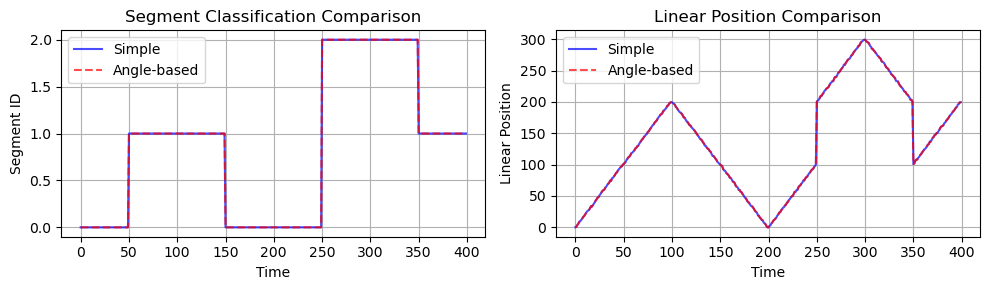

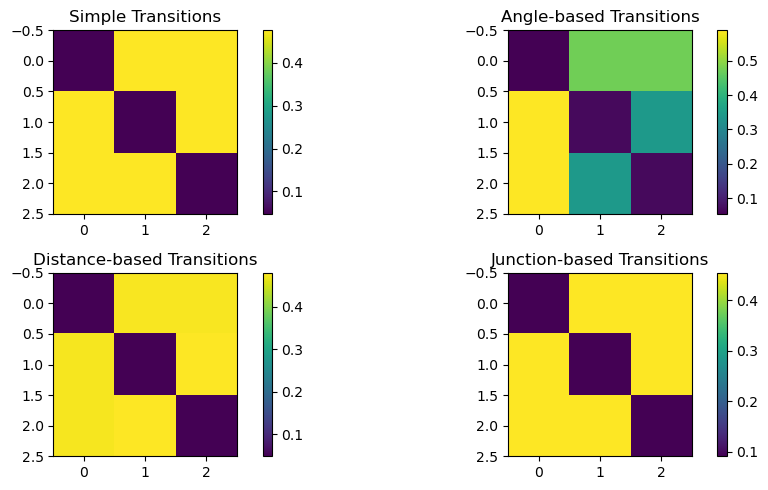

In [3]:
# Define custom node positions
node_positions = {
    0: (100, 0),
    1: (100, 100),
    2: (15, 150),
    3: (185, 150),
}

# Define custom edges
edges = [
    (0, 1),
    (1, 2),
    (1, 3),
]


track_graph = create_track_graph(node_positions=node_positions, edges=edges)
# Define edge order and spacing
edge_order = [(0, 1), (1, 2), (1, 3)]
edge_spacing = 1

# Try different transition types
result_df_simple = get_linearized_position(
    position, track_graph,
    edge_order=edge_order,
    edge_spacing=edge_spacing,
    use_HMM=True,
    transition_type='simple'
)

result_df_angle = get_linearized_position(
    position, track_graph,
    edge_order=edge_order,
    edge_spacing=edge_spacing,
    use_HMM=True,
    transition_type='angle'
)

# Visualize the results
plt.figure(figsize=(10, 3))

# Plot segment IDs
plt.subplot(1, 2, 1)
plt.plot(result_df_simple['track_segment_id'], 'b-', label='Simple', alpha=0.7)
plt.plot(result_df_angle['track_segment_id'], 'r--', label='Angle-based', alpha=0.7)
plt.title('Segment Classification Comparison')
plt.xlabel('Time')
plt.ylabel('Segment ID')
plt.legend()
plt.grid(True)

# Plot linear positions
plt.subplot(1, 2, 2)
plt.plot(result_df_simple['linear_position'], 'b-', label='Simple', alpha=0.7)
plt.plot(result_df_angle['linear_position'], 'r--', label='Angle-based', alpha=0.7)
plt.title('Linear Position Comparison')
plt.xlabel('Time')
plt.ylabel('Linear Position')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

# If you want to see the transition matrices:
transition_matrices = analyze_transition_matrices(track_graph, position)

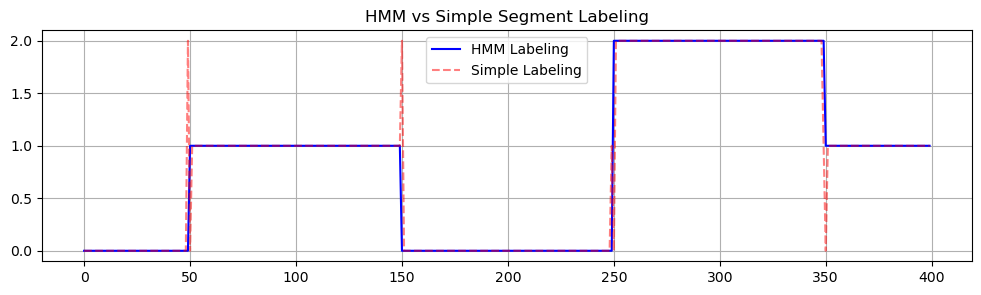

In [4]:
# Compare HMM vs non-HMM labeling
result_hmm = get_linearized_position(position, track_graph, use_HMM=True)
result_no_hmm = get_linearized_position(position, track_graph, use_HMM=False)

plt.figure(figsize=(12, 3))
plt.plot(result_hmm['track_segment_id'], 'b-', label='HMM Labeling')
plt.plot(result_no_hmm['track_segment_id'], 'r--', label='Simple Labeling', alpha=0.5)
plt.title('HMM vs Simple Segment Labeling')
plt.legend()
plt.grid(True)
plt.show()

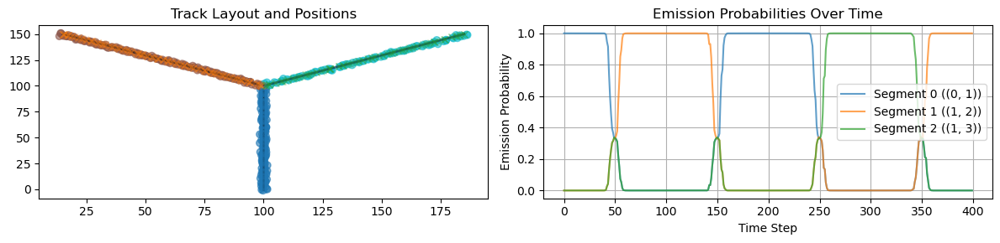

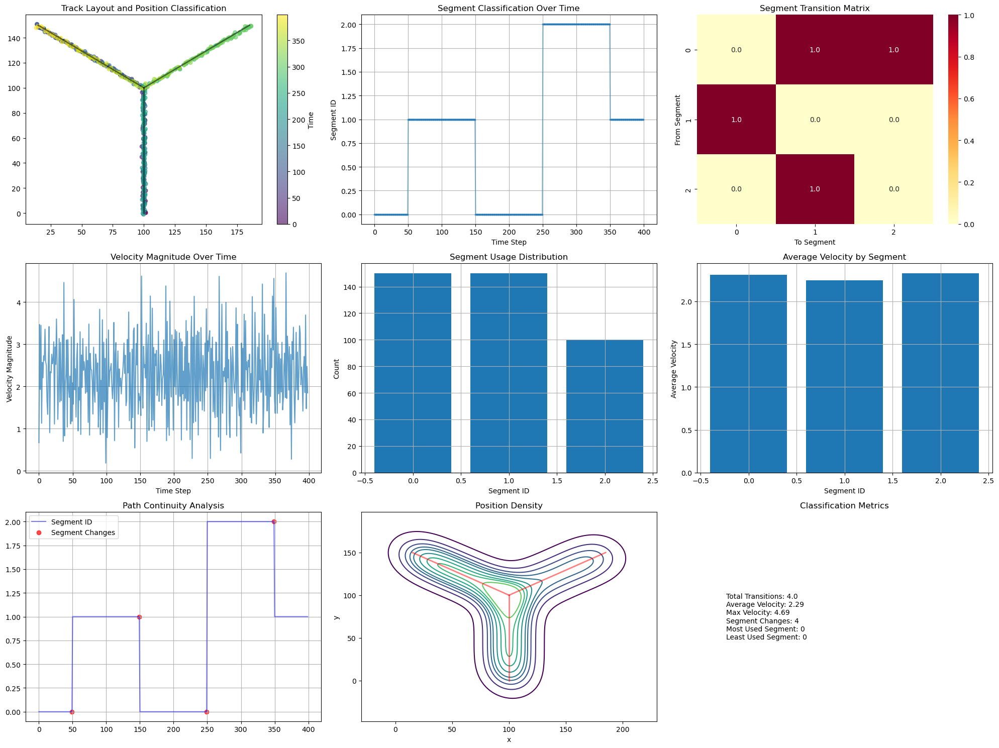

=== Track Analysis Summary ===

Segment Usage:
Segment 0: 150 points (37.5%)
Segment 1: 150 points (37.5%)
Segment 2: 100 points (25.0%)

Transition Analysis:
Total segment transitions: 4.0
Average velocity: 2.29

Most Common Transitions:
Segment 0 → 1: 1.0 times
Segment 0 → 2: 1.0 times
Segment 1 → 0: 1.0 times
Segment 2 → 1: 1.0 times


In [7]:
# Define custom node positions
node_positions = {
    0: (100, 0),
    1: (100, 100),
    2: (15, 150),
    3: (185, 150),
}

# Define custom edges
edges = [
    (0, 1),
    (1, 2),
    (1, 3),
]


track_graph = create_track_graph(node_positions=node_positions, edges=edges)
# Define edge order and spacing
edge_order = [(0, 1), (1, 2), (1, 3)]
edge_spacing = 10

# Example usage:
fig, emissions, projected_points = analyze_and_visualize_track(track_graph, position)
improved_segments = improve_edge_detection(track_graph, position, emissions)

# Example usage:
fig, metrics = enhanced_track_analysis(track_graph, position, improved_segments)
plt.show()
print_analysis_summary(metrics)


# Get linearized position with HMM
result_df = get_linearized_position(
    position,
    track_graph,
    edge_order=edge_order,
    edge_spacing=edge_spacing,
    use_HMM=True,
    route_euclidean_distance_scaling=1.0,
    sensor_std_dev=5.0,
    diagonal_bias=0.1
)
# result_df = get_linearized_position(
#     position,
#     track_graph,
#     edge_order=edge_order,
#     edge_spacing=edge_spacing,
#     use_HMM=True,  # This will now use the improved edge detection
#     sensor_std_dev=5.0,
#     diagonal_bias=0.1
# )
# # Print the results
# print(result_df)

In [8]:
anim_html = animate_track_positions(
    position, 
    track_graph, 
    result_df,
    interval=50,  # Speed of animation (lower = faster)
    tail_length=10  # Length of trail
)
display(anim_html)

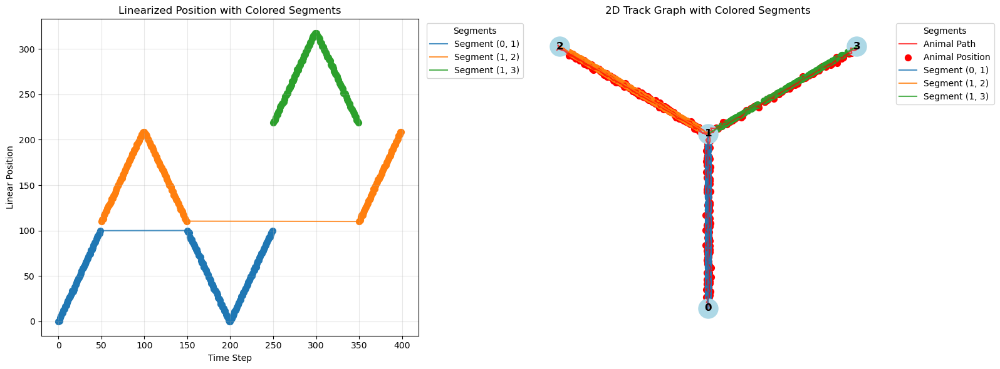

In [9]:
# Plot the linearized position and 2D position
plot_linear_and_2d_positions(track_graph, position, result_df, edge_order)

Comparing HMM different labeling methods

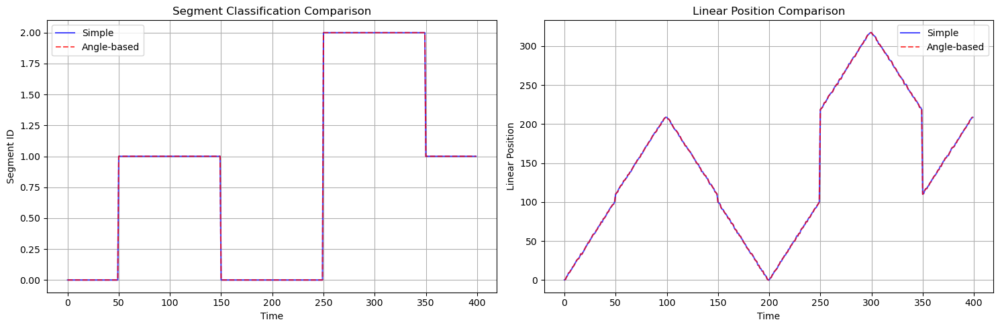

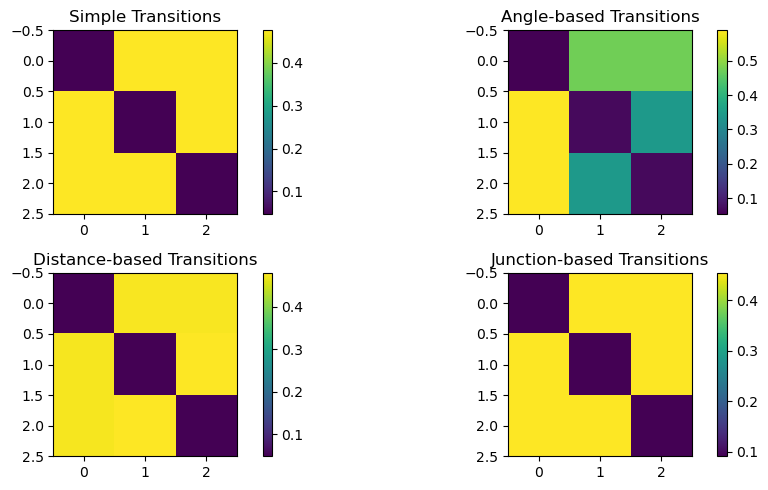

In [10]:
# Try different transition types
result_df_simple = get_linearized_position(
    position, track_graph,
    edge_order=edge_order,
    edge_spacing=edge_spacing,
    use_HMM=True,
    transition_type='simple'
)

result_df_angle = get_linearized_position(
    position, track_graph,
    edge_order=edge_order,
    edge_spacing=edge_spacing,
    use_HMM=True,
    transition_type='angle'
)

# Visualize the results
plt.figure(figsize=(15, 5))

# Plot segment IDs
plt.subplot(1, 2, 1)
plt.plot(result_df_simple['track_segment_id'], 'b-', label='Simple', alpha=0.7)
plt.plot(result_df_angle['track_segment_id'], 'r--', label='Angle-based', alpha=0.7)
plt.title('Segment Classification Comparison')
plt.xlabel('Time')
plt.ylabel('Segment ID')
plt.legend()
plt.grid(True)

# Plot linear positions
plt.subplot(1, 2, 2)
plt.plot(result_df_simple['linear_position'], 'b-', label='Simple', alpha=0.7)
plt.plot(result_df_angle['linear_position'], 'r--', label='Angle-based', alpha=0.7)
plt.title('Linear Position Comparison')
plt.xlabel('Time')
plt.ylabel('Linear Position')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

# If you want to see the transition matrices:
transition_matrices = analyze_transition_matrices(track_graph, position)